In [1]:
import pickle
import pandas as pd
import numpy as np

def get_dataset_for_classification(dataset_path, classification_path):
    
    with open(dataset_path, "rb") as file:
        X = pickle.load(file)
        
    df = pd.read_csv(classification_path)
    subjects = np.array(df.iloc[:,1])
    labels = np.array(df.iloc[:,2])
    
    X_new = {}
    y_new = {}
    
    for i, subject in enumerate(subjects):
        if subject in X:
            X_new[subject] = X[subject]
            y_new[subject] = labels[i]
    
    return X_new, y_new

In [2]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
from matplotlib.offsetbox import AnchoredText
import matplotlib.pyplot as plt
import pickle

def draw_text_in_dataset(ax, text):
    at = AnchoredText(text, loc=2, prop=dict(size=32), frameon=True)
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax.add_artist(at)
    
def plot_slices(slices, max_elements=None):

    count = slices.shape[0]
    
    if not max_elements is None:
        count = min(max_elements, count)

    rows = int(count / 4) + 1

    fig = plt.figure(figsize=(40., rows * 10.))
    grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(rows, 4),  # creates 2x2 grid of axes
                     axes_pad=0.1,  # pad between axes in inch.
                     )

    for ax, im in zip(grid, [slices[i][:,:,0] for i in range(count)]):
        ax.imshow(im)

    plt.show()
    
def plot_dataset(dataset_path, classification_path, max_elements=None):

    X, y = get_dataset_for_classification(dataset_path, classification_path)
    
    subjects = np.array(list(X.keys()))
    
    count = subjects.shape[0]
    
    if not max_elements is None:
        count = min(max_elements, count)

    rows = int(count / 4) + 1

    fig = plt.figure(figsize=(40., rows * 10.))
    grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(rows, 4),  # creates 2x2 grid of axes
                     axes_pad=0.1,  # pad between axes in inch.
                     )

    for ax, (subject, im) in zip(grid, [(subject, X[subject][0,:,:,0]) for subject in subjects[:count]]):
        ax.imshow(im)
        draw_text_in_dataset(ax, subject)
        # ax.imshow(im_roi, alpha=0.5)

    plt.show()
    
"""
Save results in plot
"""
def save_training_plot(history, output_name):

    acc = history.history['acc']
    val_acc = history.history['val_acc']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    plt.figure(figsize=(8, 8))
    plt.subplot(2, 1, 1)
    plt.plot(acc, label='Training Accuracy')
    plt.plot(val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.ylabel('Accuracy')
    plt.ylim([min(plt.ylim()),1])
    plt.title('Training and Validation Accuracy')

    plt.subplot(2, 1, 2)
    plt.plot(loss, label='Training Loss')
    plt.plot(val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.ylabel('Cross Entropy')
    # plt.ylim([0,1.0])
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')

    plt.savefig(f"{output_name}.png")
    # plt.show()
    

In [3]:
# RE_ATTILIO va eliminato da T1
# LUPO_ASSUNTA va eliminata da rCBV

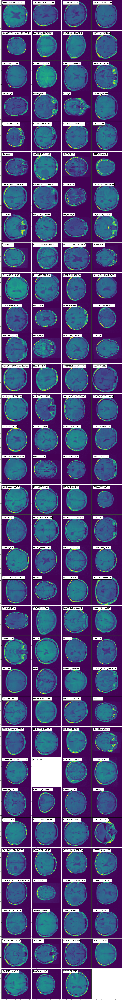

In [17]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/T1-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

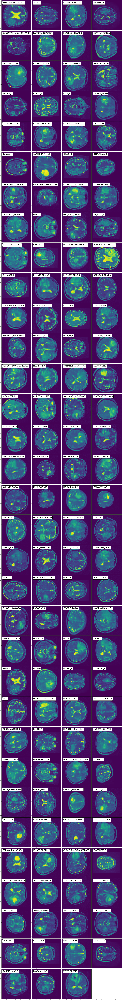

In [18]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/T2-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

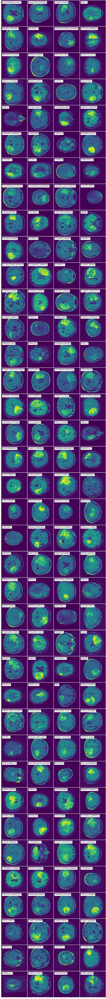

In [19]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/FLAIR-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

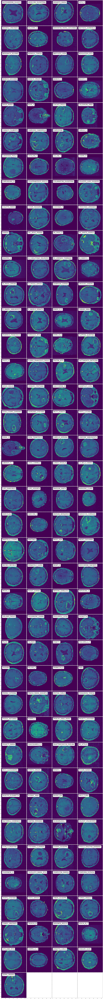

In [20]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/MPRAGE-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

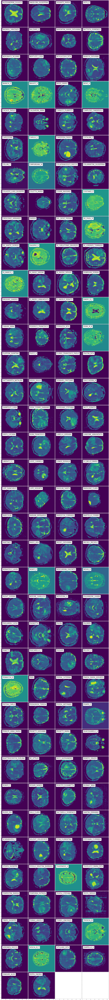

In [21]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/ADC-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

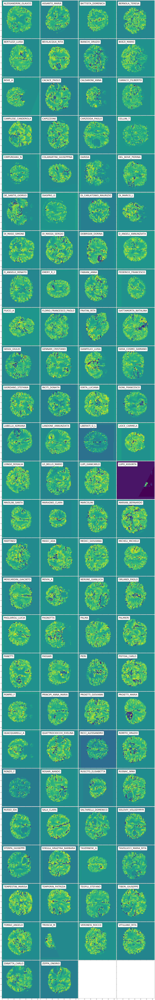

In [22]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-full-brain/rCBV-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

In [ ]:
RE_ATTILIO da T1

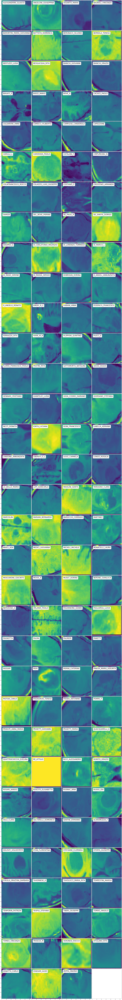

In [23]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/T1-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

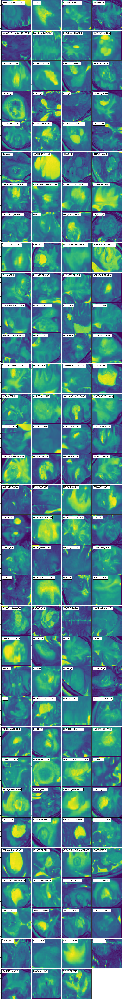

In [24]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/T2-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

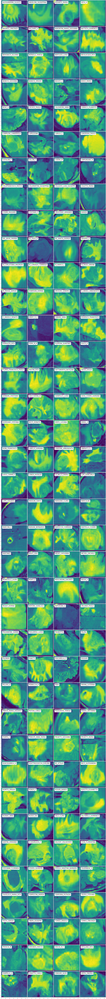

In [25]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/FLAIR-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

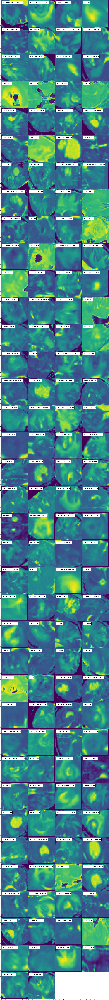

In [26]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/ADC-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

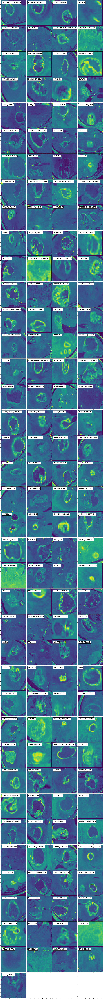

In [27]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/MPRAGE-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

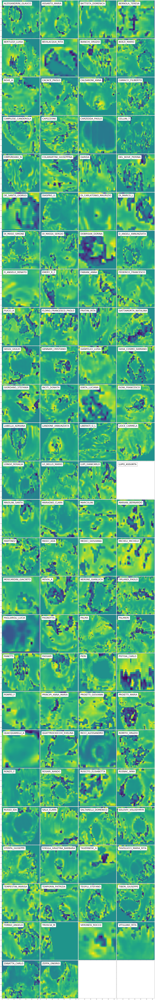

In [28]:
plot_dataset(f"/data/RMN/dataset-gliomi-cnn/datasets-tumor-crop/rCBV-64-100.pickle", 
             f"/data/RMN/dataset-gliomi-cnn/dataset-survivor.csv")

In [4]:
from numba import cuda
cuda.select_device(0)
cuda.close()

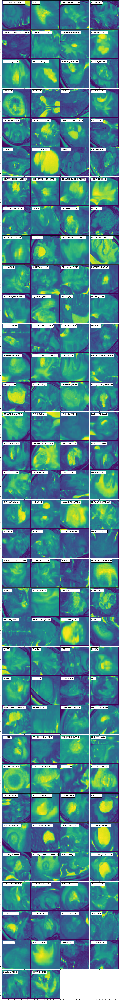

In [15]:
plot_dataset("/data/RMN/dataset-gliomi-cnn/2-datasets-tumor-crop/t2-224-100-perc.pickle")

In [35]:
"""
Article of Nature... TBD
"""

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, ZeroPadding2D

class GliomiNature2019(Model):
    
    def __init__(self, n_features, input_shape=(224,224,1), classes=2, zero_pad=True, avg_pool=True, random_seed=42):
        inputs, outpus = self.CNN_2D(n_features, input_shape, classes, zero_pad, avg_pool, random_seed)
        super(Model).__init__(inputs, outputs)

    def ConvN(self, name, X, filters, stride, batch_norm=True, max_pool=True, random_seed=42):

        for i, f in enumerate(filters):

            X = Conv2D(filters = f, 
                       kernel_size = (3, 3), 
                       strides = (stride, stride), 
                       padding = 'valid', 
                       name = f"conv-{name}-branch-{i}", 
                       kernel_initializer = glorot_uniform(seed=random_seed))(X)

            X = Activation('relu')(X)

            if batch_norm:
                X = BatchNormalization(axis = 3, 
                                       name = f"bn-{name}-branch-{i}")(X)

        if max_pool:
            X = MaxPooling2D((2, 2), strides=(stride, stride))(X)

        return X

    def CNN_2D(self, n_features, input_shape=(224,224,1), classes=2, zero_pad=True, avg_pool=True, random_seed=42):

        X = Input(input_shape)
        X_input = X

        if zero_pad:
            X = ZeroPadding2D((3, 3))(X)

        X = self.ConvN("1-a", X, [64,128,256], stride=1, batch_norm=True, max_pool=True, random_seed=random_seed)
        X = self.ConvN("2-b", X, [64,128], stride=1, batch_norm=True, max_pool=True, random_seed=random_seed)
        X = self.ConvN("3-c", X, [64], stride=2, batch_norm=True, max_pool=True, random_seed=random_seed)
        X = self.ConvN("4-d", X, [64], stride=2, batch_norm=True, max_pool=False, random_seed=random_seed)

        # X = Conv1(X,stage=1,block='a', filters=[64,128,256], s=2,batch_norm=True)
        # X = Conv2(X,stage=2,block='b', filters, s,batch_norm=True)
        # X = Conv3(X,stage=3,block='c', filters, s,batch_norm=True)
        # X = Conv4(X,stage=4,block='d', filters, s,batch_norm=True)

        if avg_pool:
            X = AveragePooling2D((2,2), name="avg_pool")(X)

        X = Flatten()(X)

        X = Dense(n_features, 
                  activation='relu', 
                  name='fc' + str(n_features), 
                  kernel_initializer = glorot_uniform(seed=random_seed))(X)

        X = Dense(classes, 
                  activation='softmax', 
                  name='fc' + str(classes), 
                  kernel_initializer = glorot_uniform(seed=random_seed))(X)

        print("Model", X)

        # Create model
        # return Model(inputs = X_input, outputs = X, name='4_Conv_Blocks_Net')
        return X_input, X

#model.get_layer('fc256')

In [36]:
model = GliomiNature2019(2)

NameError: name 'Conv2D' is not defined

In [ ]:
model.summar()